# Xgboost Regression Weekly

### Import libraries

In [1]:
import pandas as pd 
import numpy as np
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import xgboost as xgb
from sklearn.metrics import mean_squared_error,r2_score
import xgboost as xgb
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer
from sklearn.model_selection import train_test_split
import math
import datetime
import seaborn as sns;
from sklearn.preprocessing import StandardScaler

### Read Preprocessed Data & Preprocess data for feature Regression

In [5]:
data = pd.read_csv('Security_and_market_movement_unscaled_cluster_weekly_125.csv')

In [7]:
data = data.dropna(0)

In [8]:
### Drop the 'Unnamed: 0'
data.drop(columns=['Unnamed: 0'],inplace=True)

In [18]:
data_1 = data

### Read Preprocessed dummy variable

In [19]:
dummy_variable = pd.read_csv('Security_info_post_dummy.csv')

In [20]:
dummy_variable.drop(columns=['Unnamed: 0'],inplace=True)

In [21]:
dummy_variable.columns

Index(['SecurityID', '1.5 Lien Secured', '1st Lien Secured', '1st lien',
       '2nd Lien Secured', '3rd Lien Secured', 'Asset Backed',
       'Jr Subordinated Unsecured', 'Secured', 'Sr Unsecured',
       ...
       'Fixed', 'PAY-IN-KIND', 'STEP CPN', 'VARIABLE', 'WHEN ISSUED',
       'ZERO COUPON', 'MinIncrement', 'MinPiece', 'Term', 'RatingSP'],
      dtype='object', length=145)

### Feature Engineering

In [22]:
### Merge the dummy variable to the market&security change
data_1 = data_1.merge(dummy_variable,on=['SecurityID'],how='left')

In [23]:
data_1.KeyDate.unique()

array(['2019-01-07', '2019-01-14', '2019-01-21', '2019-01-28',
       '2019-02-04', '2019-02-11', '2019-02-18', '2019-02-25',
       '2019-03-04', '2019-03-11', '2019-03-18', '2019-03-25',
       '2019-04-01', '2019-04-08', '2019-04-15', '2019-04-22',
       '2019-04-29', '2019-05-06', '2019-05-13', '2019-05-20',
       '2019-05-27', '2019-06-03', '2019-06-10', '2019-06-17',
       '2019-06-24', '2019-07-08', '2019-07-15', '2019-07-22',
       '2019-07-29', '2019-08-05', '2019-08-12', '2019-08-19',
       '2019-08-26', '2019-09-09', '2019-09-16', '2019-09-23',
       '2019-09-30', '2019-10-07', '2019-10-14', '2019-10-21',
       '2019-10-28', '2019-12-30', '2019-11-04', '2019-11-11',
       '2019-11-18', '2019-11-25', '2019-12-02', '2019-12-09',
       '2019-12-16', '2019-12-23'], dtype=object)

In [24]:
data_1["RatingSP"] = data_1['RatingSP'].fillna(data_1.groupby('Group')['RatingSP'].transform('mean'))

In [25]:
data_1.head()

,SecurityID,KeyDate,YieldWorst,ModifiedDuration_Plain,AmtOutstanding,Target_G_change,YieldWorst_change,ModifiedDuration_Plain_change,Group,Cluster_average_AmountIssued,...,Fixed,PAY-IN-KIND,STEP CPN,VARIABLE,WHEN ISSUED,ZERO COUPON,MinIncrement,MinPiece,Term,RatingSP
0,56535.0,2019-01-07,26.5895,1.83121,300000000.0,-49.59,-0.013582,-0.006677,Cluster 83,6.380922e+08,...,0,0,0,0,0,0,1000.0,200000.0,3,15.485527
1,56535.0,2019-01-14,21.5434,1.86436,300000000.0,-512.50,-0.189778,0.018103,Cluster 83,6.380922e+08,...,0,0,0,0,0,0,1000.0,200000.0,3,15.485527
2,56535.0,2019-01-21,18.5140,1.88186,300000000.0,-299.50,-0.140618,0.009387,Cluster 83,6.380922e+08,...,0,0,0,0,0,0,1000.0,200000.0,3,15.485527
3,56535.0,2019-01-28,17.5268,1.87785,300000000.0,-90.43,-0.053322,-0.002131,Cluster 83,6.380922e+08,...,0,0,0,0,0,0,1000.0,200000.0,3,15.485527
4,56535.0,2019-02-04,17.7659,1.85843,300000000.0,27.60,0.013642,-0.010342,Cluster 83,6.380922e+08,...,0,0,0,0,0,0,1000.0,200000.0,3,15.485527


In [26]:
data_1['KeyDate'] = pd.to_datetime(data_1['KeyDate'])

In [27]:
type(data_1['KeyDate'].iloc[0])

pandas._libs.tslibs.timestamps.Timestamp

###Select a given period:
data_1 = data_1[(data_1['KeyDate']>= datetime.datetime(2018,12,31))&(data_1['KeyDate']<= datetime.datetime(2019,2,28))]

In [1]:
data_1.head()

NameError: name 'data_1' is not defined

data_1 = data_1.groupby('SecurityID').agg(np.random.choice)

In [29]:
final_regression_data = data_1.loc[:,'ModifiedDuration_Plain':'RatingSP']

In [30]:
final_regression_data.dropna(inplace=True)

In [31]:
final_regression_data.columns

Index(['ModifiedDuration_Plain', 'AmtOutstanding', 'Target_G_change',
       'YieldWorst_change', 'ModifiedDuration_Plain_change', 'Group',
       'Cluster_average_AmountIssued', 'Cluster_average_Coupon',
       'Cluster_average_Term', 'Cluster_average_Rating',
       ...
       'Fixed', 'PAY-IN-KIND', 'STEP CPN', 'VARIABLE', 'WHEN ISSUED',
       'ZERO COUPON', 'MinIncrement', 'MinPiece', 'Term', 'RatingSP'],
      dtype='object', length=190)

In [32]:
#final_regression_data.replace([np.inf, -np.inf], np.NaN, inplace=True)

In [33]:
#final_regression_data.dropna(inplace=True)

### Set the Target and the Features

In [34]:
Y = final_regression_data['Target_G_change']
X = final_regression_data.drop(columns =['Target_G_change','Group'])

In [35]:
Y

0         -49.590
1        -512.500
2        -299.500
3         -90.430
4          27.600
           ...   
724371      2.754
724372     -6.099
724373    -33.788
724374     -6.522
724375    -13.190
Name: Target_G_change, Length: 724376, dtype: float64

In [36]:
len(X)

724376

### Remove Outliers in the period
We Select the 5 Percentile to 95 percentile

In [75]:
removed_outliers = Y.between(Y.quantile(.02), Y.quantile(.98))

In [76]:
Y.quantile(.99)

46.22

In [77]:
print(removed_outliers.value_counts())

True     681501
False     28387
Name: Target_G_change, dtype: int64


In [50]:
X = X[removed_outliers]
Y = Y[removed_outliers]

In [51]:
columns = X.columns
index = X.index

In [52]:
transformer = StandardScaler().fit(X)
X = transformer.transform(X)

In [53]:
X = pd.DataFrame(data=X,    # values
    index=index,    # 1st column as index
columns=columns)

In [54]:
print(len(X),len(Y))

709888 709888


In [55]:
### Split the X,Y to training and testing data
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, random_state=10)

In [56]:
### set up the the xgb regression
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.1, learning_rate = 0.1,
                max_depth =100, alpha = 100, n_estimators = 100)

In [57]:
xg_reg.fit(X_train,y_train)

XGBRegressor(alpha=100, base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=100,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
             reg_alpha=100, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [58]:
preds = xg_reg.predict(X_test)
pred_train= xg_reg.predict(X_train)

In [59]:
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))
r2_test = r2_score(y_test, preds)
r2_train = r2_score(y_train,pred_train)
print("Test R2:{}".format(r2_test))
print("Train R2:{}".format(r2_train))

RMSE: 7.338463
Test R2:0.722720746751373
Train R2:0.8114191357270064


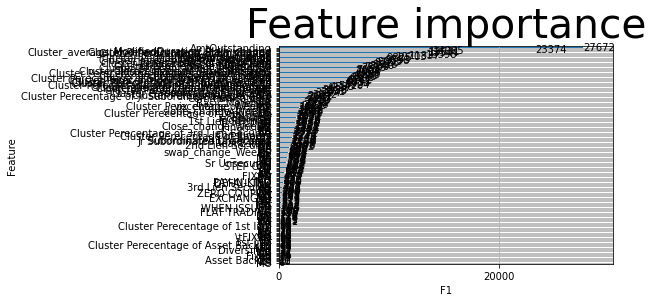

In [60]:
import matplotlib as mpl
xgb.plot_importance(xg_reg)
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.figsize'] = [400, 400]
plt.rcParams.update({'font.size': 34})
plt.title('Feature importance')
plt.xlabel('F1')
plt.ylabel('Feature')
plt.show()

In [61]:
import matplotlib.pyplot as plt
xgb.plot_tree(xg_reg,num_trees=0,rankdir='LR')
plt.rcParams['figure.figsize'] = [100, 100]
plt.show()

In [62]:
columns

Index(['ModifiedDuration_Plain', 'AmtOutstanding', 'YieldWorst_change',
       'ModifiedDuration_Plain_change', 'Cluster_average_AmountIssued',
       'Cluster_average_Coupon', 'Cluster_average_Term',
       'Cluster_average_Rating',
       'Cluster Perecentage of Jr Subordinated Unsecured',
       'Cluster Perecentage of Secured',
       ...
       'Fixed', 'PAY-IN-KIND', 'STEP CPN', 'VARIABLE', 'WHEN ISSUED',
       'ZERO COUPON', 'MinIncrement', 'MinPiece', 'Term', 'RatingSP'],
      dtype='object', length=188)

### After Feature Importance

new_X = X[['YieldWorst_change','vix_change','swap_change','Cluster_average_YieldWorst_change','Cluster_average_Rating','Cluster_average_ModifiedDuration_Plain_change','Close_change','MinIncrement','ModifiedDuration_Plain_change','Cluster Perecentage of Secured','Cluster_average_Coupon','slope_change','Cluster_G_change','skew_change','DEFAULTED','Term','Cluster_average_Term']]

new_X.tail()

X_train, X_test, y_train, y_test = train_test_split(new_X, Y, test_size=0.33, random_state=10)

xg_reg2 = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.1, learning_rate = 0.1,
                max_depth =100, alpha = 100, n_estimators = 50)

xg_reg2.fit(X_train,y_train)

preds = xg_reg2.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))
r2 = r2_score(y_test, preds)
print("R2:{}".format(r2))

import matplotlib as mpl
xgb.plot_importance(xg_reg2)
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.figsize'] = [200, 200]
plt.rcParams.update({'font.size': 34})
plt.title('Feature importance')
plt.xlabel('F1')
plt.ylabel('Feature')
plt.show()

import matplotlib.pyplot as plt
xgb.plot_tree(xg_reg2,num_trees=0,rankdir='LR')
plt.rcParams['figure.figsize'] = [1000, 1000]
plt.show()

GLM

In [39]:
from sklearn import linear_model
reg = linear_model.Ridge(alpha=0.01)
reg.fit(X_train,y_train)

Ridge(alpha=0.01)

In [40]:
preds = reg.predict(X_test)
pred_train= reg.predict(X_train)

In [41]:
rmse_test = np.sqrt(mean_squared_error(y_test, preds))
rmse_train = np.sqrt(mean_squared_error(y_train, pred_train))
print("RMSE Test: %f" % (rmse_test))
print("RMSE Train: %f" % (rmse_train))
r2_test = r2_score(y_test, preds)
r2_train = r2_score(y_train,pred_train)
print("R2 Test:{}".format(r2_test))
print("R2 Train:{}".format(r2_train))

RMSE Test: 3.195597
RMSE Train: 3.192427
R2 Test:0.29927321781856364
R2 Train:0.2973577544788546


X.corr()

In [78]:
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_regression
regr = MLPRegressor(random_state=42, max_iter=100).fit(X_train, y_train)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:585: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


In [79]:
preds = regr.predict(X_test)
pred_train= regr.predict(X_train)

In [80]:
rmse_test = np.sqrt(mean_squared_error(y_test, preds))
rmse_train = np.sqrt(mean_squared_error(y_train, pred_train))
print("RMSE Test: %f" % (rmse_test))
print("RMSE Train: %f" % (rmse_train))
r2_test = r2_score(y_test, preds)
r2_train = r2_score(y_train,pred_train)
print("R2 Test:{}".format(r2_test))
print("R2 Train:{}".format(r2_train))

RMSE Test: 7.708356
RMSE Train: 4.891957
R2 Test:0.69406388500122
R2 Train:0.8762461506085919


In [81]:
regr.get_params()

{'activation': 'relu',
 'alpha': 0.0001,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (100,),
 'learning_rate': 'constant',
 'learning_rate_init': 0.001,
 'max_fun': 15000,
 'max_iter': 100,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 42,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}